# Imports

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt
import scanpy as sc
from matplotlib import rcParams
import gc
import glob
import numpy as np
from matplotlib.colors import to_hex


In [ ]:
import warnings
warnings.filterwarnings("ignore")
rcParams['figure.figsize'] = (4, 3)

# Functions

In [ ]:
def load_adata(suffix, model='reference_query_mapping', dataset='nanostring_cosmx_human_nsclc'):    
    model_folder = glob.glob(f'../../../artifacts/{dataset}/models/{model}/*_{suffix}')[0]
    adata_path = f"{model_folder}/{dataset}_{model}.h5ad"
    adata = sc.read_h5ad(adata_path)
    
    from matplotlib.colors import to_hex
    batch_colors = np.apply_along_axis(to_hex, 1, np.array(plt.get_cmap('tab20b').colors)[[0,1,3,5,8,11,13,17],:])
    batch_colors = {b: c for b, c in zip(['lung5_rep1','lung5_rep2','lung5_rep3','lung6','lung9_rep1','lung9_rep2','lung12','lung13'], batch_colors)}
    adata.uns['batch_colors'] = [batch_colors[b] for b in adata.obs.batch.unique()]
    
    return adata, adata_path

In [ ]:
def plot_cluster_proportions(cluster_props, 
                             cluster_palette=None,
                             xlabel_rotation=0,
                             figsize=(9,4),
                             ax=None,
                             figs=None): 
    if ax is None:
        figs, ax = plt.subplots(figsize=figsize)
        figs.patch.set_facecolor("white")
        figs.tight_layout()
        
    cmap = None
    if cluster_palette is not None:
        cmap = sns.palettes.blend_palette(
            cluster_palette, 
            n_colors=len(cluster_palette), 
            as_cmap=True)    
   
    cluster_props.plot(
        kind="bar", 
        stacked=True, 
        ax=ax, 
        legend=None, 
        colormap=cmap
    )
    
    ax.legend(bbox_to_anchor=(1.01, 1), frameon=False, title="Cluster").remove()
    sns.despine(figs, ax)
    ax.tick_params(axis="x", rotation=xlabel_rotation)
    ax.tick_params(axis="y", rotation=90)
    ax.set_xlabel(cluster_props.index.name.capitalize())
    ax.set_ylabel("Proportion")

    return ax

In [ ]:
def plot_latent(adata, model='reference_query_mapping'):
    
    # plot umap and spatial with general characteristics
    if model == 'reference_query_mapping':
        query = adata.obs.batch[adata.obs.mapping_entity=='query'].unique()[0]
        sc.pl.umap(adata, color=['mapping_entity','cell type', 'batch','niche'], ncols=4, wspace=0.5, size=0.5)
        sc.pl.embedding(adata[adata.obs.batch==query], basis="spatial", color=['cell type', 'niche'], ncols=2, wspace=0.5, size=1)
        
    elif model == 'reference':
        sc.pl.umap(adata, color=['batch','cell type','niche'], ncols=3, wspace=0.5, size=0.5)

    # plot clusters
    cluster_res = adata.obs.columns[adata.obs.columns.str.contains('latent_leiden_')]
    for cl in cluster_res:
        del adata.uns[f'{cl}_colors']
    sc.pl.umap(adata, color=cluster_res, ncols=4, wspace=0.5, size=0.5, palette=sc.pl.palettes.vega_20_scanpy)
    
    if model == 'reference_query_mapping':
        sc.pl.embedding(adata[adata.obs.batch==query], basis="spatial", color=cluster_res, ncols=4, wspace=0.5, size=1)    
        
    return

In [ ]:
def res_details(adata, resolution=0.4, model='reference_query_mapping'):

    # plot spatial for all samples
    fig, axes = plt.subplots(nrows=2, ncols=4, figsize=(18, 6))
    for i, batch in enumerate(adata.obs.batch.unique()):
        if i < 4:
            sc.pl.embedding(adata[adata.obs.batch==batch], basis="spatial", color=f'latent_leiden_{resolution}', size=1, show=False, ax=axes[0,i], title=batch)
        else:
            sc.pl.embedding(adata[adata.obs.batch==batch], basis="spatial", color=f'latent_leiden_{resolution}', size=1, show=False, ax=axes[1,i-4], title=batch)
    plt.tight_layout()
    plt.show()
    
    # plot proportions
    figs, axes = plt.subplots(nrows=1, ncols=3, figsize=(18, 3))
    plot_var = f'latent_leiden_{resolution}'
    
    for i, cluster_var in enumerate(['cell type', 'niche', 'batch']):
        props = adata.obs.groupby([cluster_var, plot_var]).size().reset_index()
        props = props.pivot(columns=plot_var, index=cluster_var).T
        props.index = props.index.droplevel(0)
        props.fillna(0, inplace=True)
        props = props.div(props.sum(axis=1), axis=0)*100 
        axes[i] = plot_cluster_proportions(props, xlabel_rotation=90, cluster_palette=adata.uns[f'{cluster_var}_colors'], figsize=(4,3), ax=axes[i], figs=figs)
    figs.show()

    return

In [ ]:
from matplotlib.colors import ListedColormap, to_rgb, to_hex
def colorFader(c1, c2='#FFFFFF', n=10, mix=0):
    n+=1
    c1=np.array(to_rgb(c1))
    c2=np.array(to_rgb(c2))
    colors=[]
    for x in range(n+1):
         colors.append(to_hex((1-x/n)*c1 + c2*x/n))
    return colors[:-1]

# Reference 43
no contrastive, L1 0 add on, 1000 masked, decrease kl x10, 0.03 active GPs

## Select resolution

### reference

In [ ]:
adata, adata_path = load_adata(suffix='43', model='reference')

In [ ]:
# merge super small cluster
adata.obs.loc[(adata.obs['latent_leiden_0.4']=='11').values,'latent_leiden_0.4'] = '6'
adata.obs.loc[(adata.obs['latent_leiden_0.45']=='12').values,'latent_leiden_0.45'] = '7'
adata.obs.loc[(adata.obs['latent_leiden_0.5']=='12').values,'latent_leiden_0.5'] = '7'

adata.obs['latent_leiden_0.4'] = adata.obs['latent_leiden_0.4'].cat.remove_unused_categories()
adata.obs['latent_leiden_0.45'] = adata.obs['latent_leiden_0.45'].cat.remove_unused_categories()
adata.obs['latent_leiden_0.5'] = adata.obs['latent_leiden_0.5'].cat.remove_unused_categories()

In [ ]:
plot_latent(adata, model='reference')

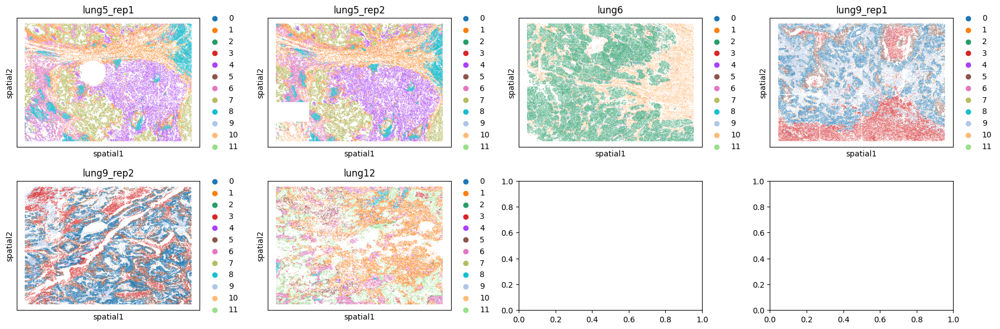

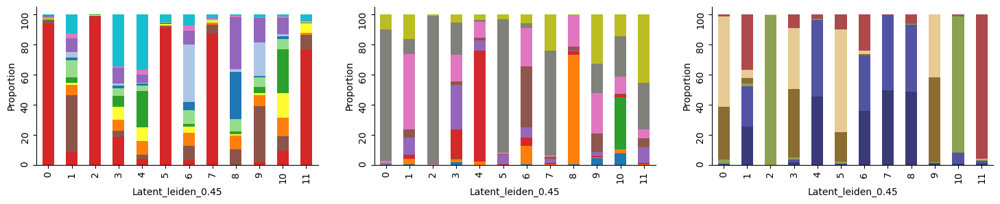

In [11]:
latent_leiden_resolution=0.45
res_details(adata, resolution=latent_leiden_resolution, model='reference')

In [12]:
if not 'cluster_grups' in adata.uns:
    adata.uns['cluster_groups'] = {}
    
adata.uns['cluster_groups'][f"latent_leiden_0.35"] = {
    'tumor_clusters': ['0','2', '3', '6'],
    'stroma_clusters': ['1', '9'],
    'neutrophil_clusters': ['4', '5'],
    'macrophage_clusters': ['10'],
    'lymphoid_clusters': ['7', '8', '9']
}

In [13]:
sc.tl.dendrogram(adata, groupby=f"latent_leiden_{latent_leiden_resolution}", use_rep='nichecompass_latent', n_pcs=adata.obsm['nichecompass_latent'].shape[1])
adata.obs[f'latent_leiden_{latent_leiden_resolution}'] = adata.obs[f'latent_leiden_{latent_leiden_resolution}'].cat.reorder_categories(adata.uns[f'dendrogram_latent_leiden_{latent_leiden_resolution}']['categories_ordered'], ordered=True)

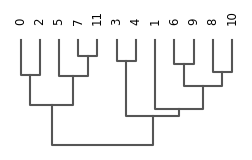

In [14]:
rcParams['figure.figsize'] = (3, 1.5)
sc.pl.dendrogram(adata, groupby=f"latent_leiden_{latent_leiden_resolution}", orientation='bottom')
rcParams['figure.figsize'] = (4, 3)

In [41]:
if not 'cluster_grups' in adata.uns:
    adata.uns['cluster_groups'] = {}
    
adata.uns['cluster_groups'][f"latent_leiden_0.45"] = {
    'tumor_clusters': ['0', '2', '5', '7', '11'],
    'stroma_clusters': ['3', '4', '1', '6', '9', '8', '10'],
    'neutrophil_clusters': ['3', '4'],
    'macrophage_clusters': ['10'],
    'lymphoid_clusters': ['6', '9', '8']
}

In [42]:
adata.uns['cluster_groups']

{'latent_leiden_0.45': {'tumor_clusters': ['0', '2', '5', '7', '11'],
  'stroma_clusters': ['3', '4', '1', '6', '9', '8', '10'],
  'neutrophil_clusters': ['3', '4'],
  'macrophage_clusters': ['10'],
  'lymphoid_clusters': ['6', '9', '8']}}

In [15]:
adata.uns[f'dendrogram_latent_leiden_{latent_leiden_resolution}']['categories_ordered']

['0', '2', '5', '7', '11', '3', '4', '1', '6', '9', '8', '10']

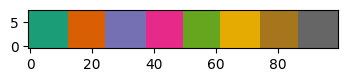

In [17]:
rcParams['figure.figsize'] = (4, 0.5)
general=np.apply_along_axis(to_hex, 1, np.array(plt.get_cmap('Dark2').colors))
a=np.outer(np.ones(len(general)),np.arange(0,1,0.01))   # pseudo image data
plt.imshow(a,aspect='auto',cmap=plt.get_cmap('Dark2'),origin="lower")
rcParams['figure.figsize'] = (4, 3)

In [18]:
# use dendogram to define niche palette related to cell type
general=np.apply_along_axis(to_hex, 1, np.array(plt.get_cmap('Dark2').colors))
tumor=colorFader(general[2], c2='#FFFFFF', n=5, mix=0)
lymphoid=general[4]
myeloid=general[1]
Blike=colorFader(general[0], c2='#FFFFFF', n=2, mix=0)
neutrophil=colorFader(general[3], c2='#FFFFFF', n=2, mix=0)
stroma=general[5]


leiden_colDict = {
    '0': tumor[0], '2': tumor[1], '5': tumor[2], '7': tumor[3], '11': tumor[4], 
    '3': neutrophil[0], '4': neutrophil[1], 
    '1': stroma, '6': Blike[0], '9': Blike[1], '8': lymphoid, '10': myeloid 
}
adata.uns[f'latent_leiden_{latent_leiden_resolution}_colors'] = [x for x in leiden_colDict.values()]

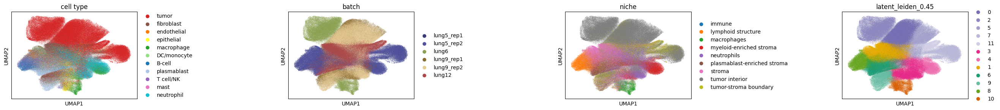

In [19]:
sc.pl.umap(adata, color=['cell type', 'batch','niche', f"latent_leiden_{latent_leiden_resolution}"], ncols=4, wspace=1, size=0.5)

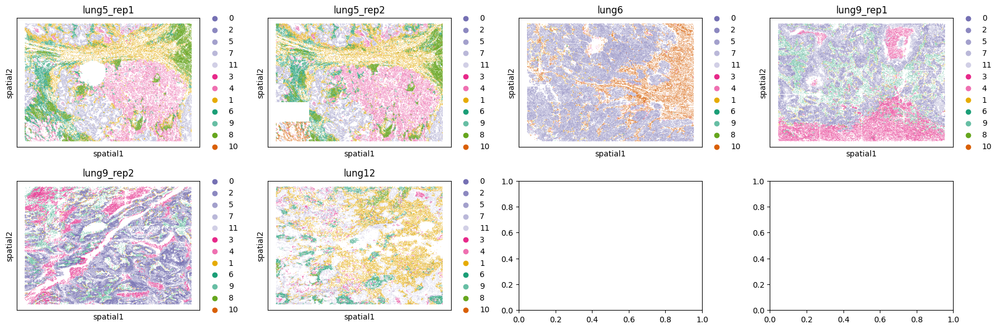

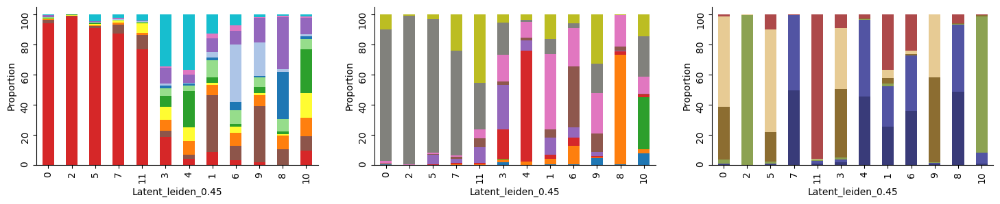

In [20]:
latent_leiden_resolution=0.45
res_details(adata, resolution=latent_leiden_resolution, model='reference')

lung5_rep1


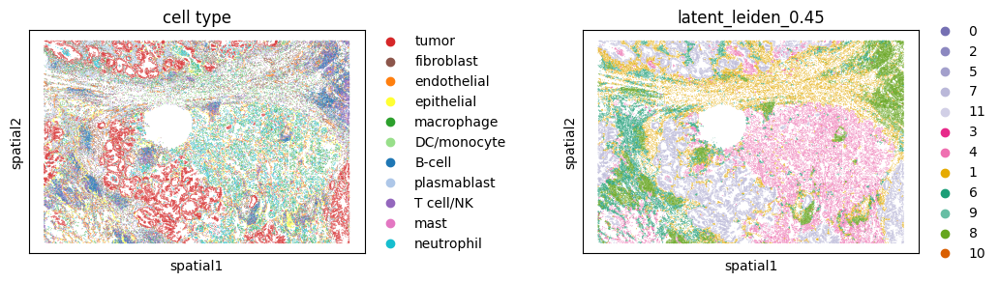

lung5_rep2


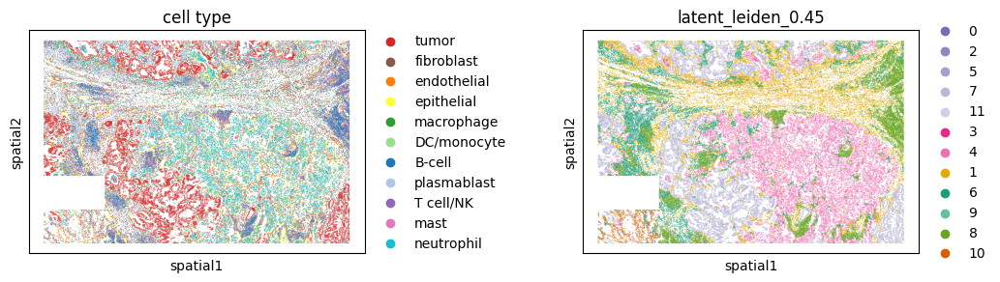

lung6


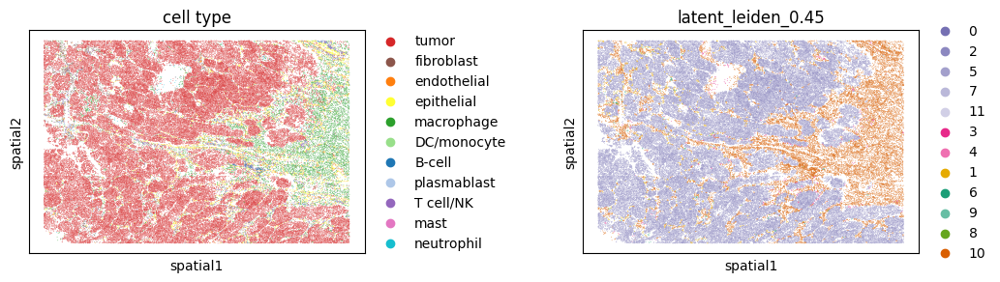

lung9_rep1


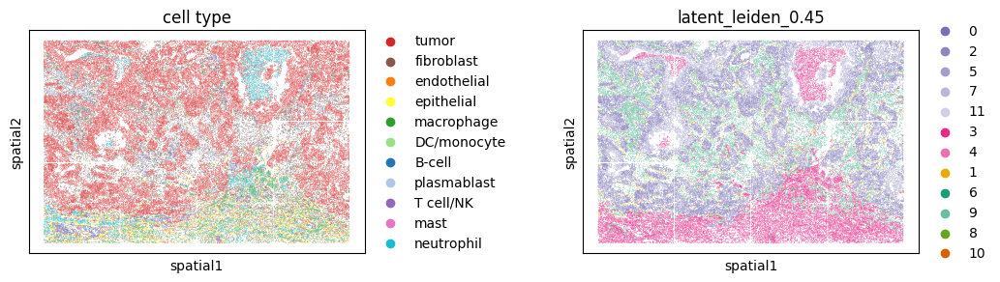

lung9_rep2


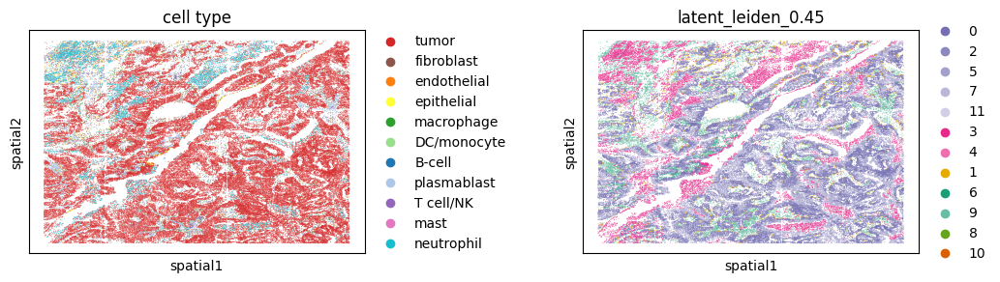

lung12


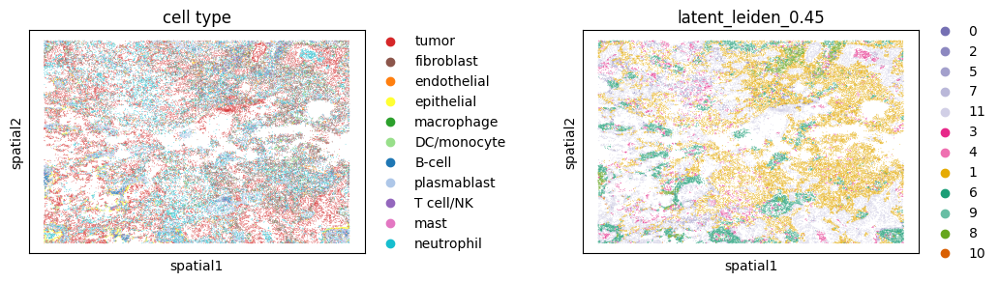

In [21]:
for batch in adata.obs.batch.unique():
    print(batch)
    sc.pl.embedding(adata[adata.obs.batch==batch], basis="spatial", color=['cell type', 'latent_leiden_0.45'], ncols=2, wspace=0.5, size=1)

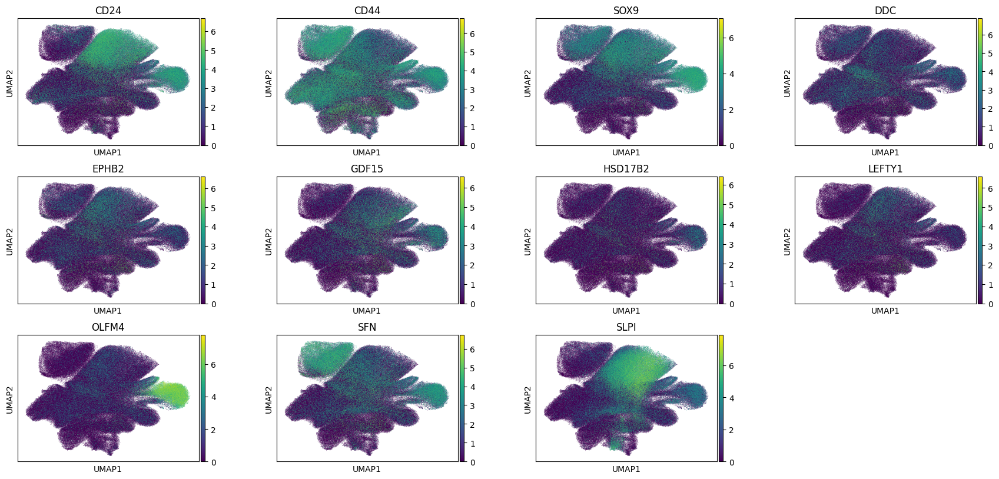

In [22]:
stem_cells_markers = np.array(['CD24', 'DCLK1', 'LGR5', 'CD166', 'CD44', 'DCAMKL-1', 'SOX9', 'ACAD10', 'ACVR1C', 'ADH1C', 'ALDH1', 'ALK3', 'ARSE', 
'ASCL2', 'ATP10B', 'BMI1', 'C16orf89', 'C6orf136', 'CD29', 'CDCA7', 'CFTR','CHMP4C', 'CHP2', 'CLDN15', 'CLDN18', 'CLDN2', 'CPA6', 'DAPK2', 
'DDC', 'EFNA3', 'EPHB2', 'EPYC', 'EVPL', 'F2RL1', 'FBLN2', 'FOXD2-AS1', 'GATA6-AS1', 'GDF15', 'GJB1', 'GJB1', 'GOLT1A', 'GPX2', 'HNF1A', 
'HSD17B2', 'ITPKC','LEFTY1', 'LHFPL3-AS2', 'LIPG', 'LY6G6D', 'MGST1', 'MSI1', 'MYOM3', 'Musashi-1', 'NOX1', 'OLFM4', 'PCSK9', 'PDZD3', 
'PHLDA1', 'PKP2', 'PLAGL2', 'PLEKHH1', 'PPP1R1B', 'PTGDR', 'PTK7', 'RGMB', 'RNF157', 'RNF186', 'SFN', 'SLC27A2', 'SLC38A4', 'SLPI',
'SULT1B1', 'TAF4B', 'TANC1', 'TMEM171', 'TSPAN8', 'Telomerase Inhibitors', 'URB1-AS1', 'ZBED9', 'ZNF296', 'ASCL2', 
'SMOC2', 'CD133', 'ABCG2', 'ALDH1A1'])
stem_cells_markers = [sc for sc in stem_cells_markers if sc in adata.var_names]
sc.pl.umap(adata, color=stem_cells_markers, ncols=4, wspace=0.3, size=0.5)

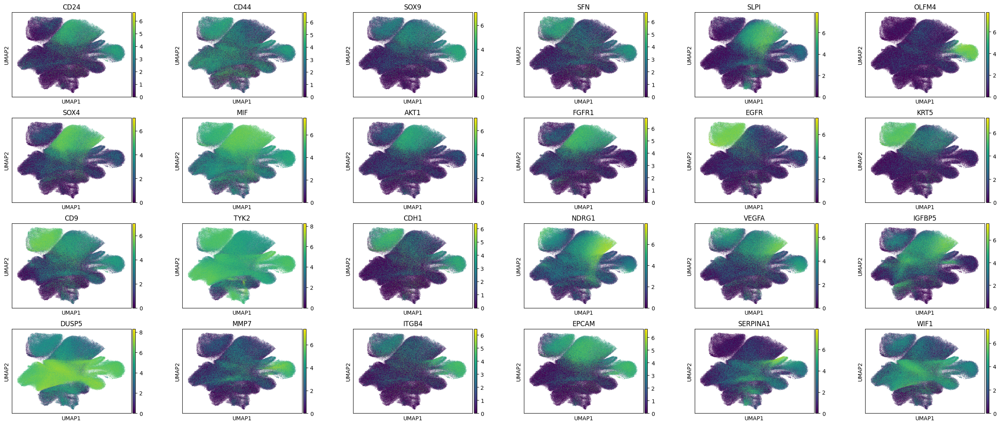

In [156]:
sc.pl.umap(adata, color=['CD24','CD44','SOX9','SFN','SLPI','OLFM4','SOX4','MIF','AKT1','FGFR1','EGFR','KRT5','CD9','TYK2','CDH1','NDRG1','VEGFA','IGFBP5','DUSP5','MMP7','ITGB4','EPCAM','SERPINA1','WIF1'], ncols=6, wspace=0.3, size=0.5)

In [43]:
adata.write_h5ad(adata_path)

tumor_clusters


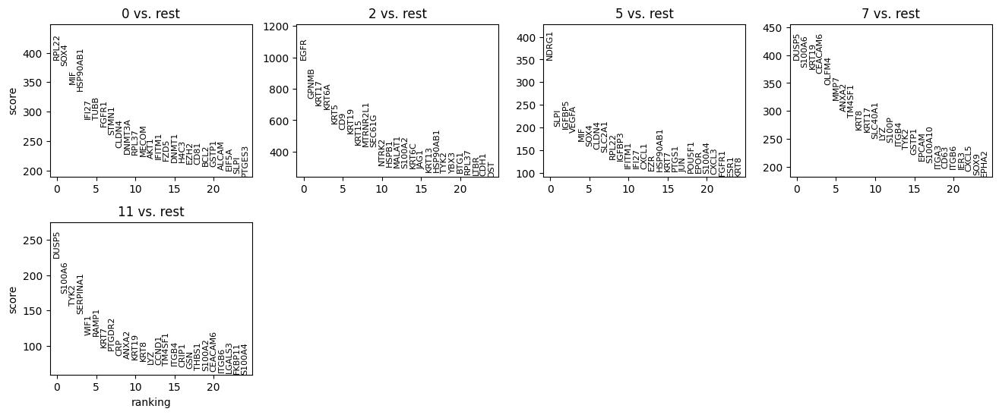

stroma_clusters


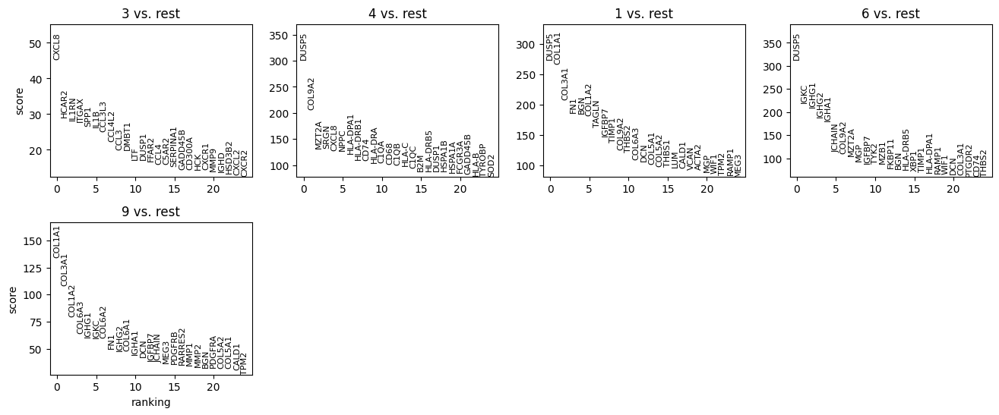

neutrophil_clusters


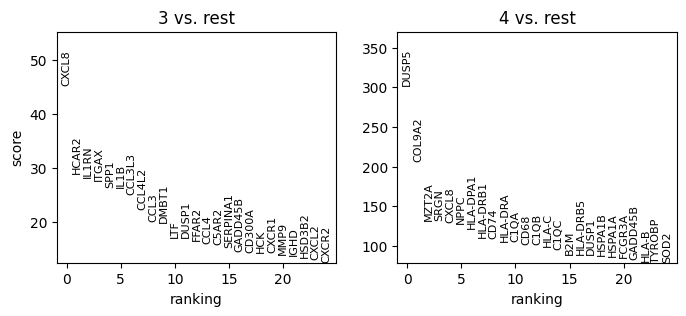

macrophage_clusters


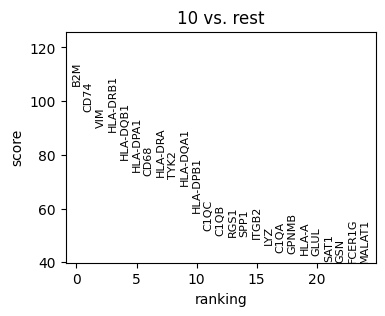

lymphoid_clusters


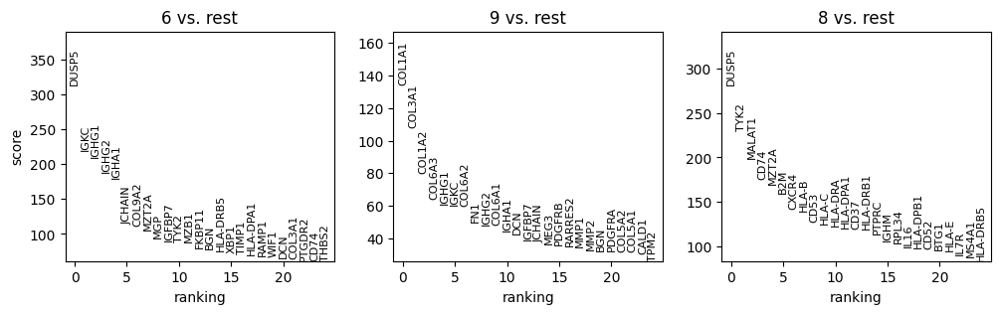

In [111]:
for structure, clusters in adata.uns['cluster_groups'][f"latent_leiden_{latent_leiden_resolution}"].items():
    print(structure)
    sc.tl.rank_genes_groups(adata, f"latent_leiden_{latent_leiden_resolution}", groups=clusters)
    sc.pl.rank_genes_groups(adata, n_genes=25, sharey=False)

In [161]:
adata.obs.batch.unique()

['lung5_rep1', 'lung5_rep2', 'lung6', 'lung9_rep1', 'lung9_rep2', 'lung12']
Categories (6, object): ['lung5_rep1', 'lung5_rep2', 'lung6', 'lung9_rep1', 'lung9_rep2', 'lung12']

In [162]:
from sklearn.neighbors import NearestNeighbors
rcParams['figure.figsize'] = (10, 4)

for n in [25]:
    # compute n neighbours per cell type
    knn = {}
    cell_counts = {}
    b = 'lung12'
    X = adata[adata.obs.batch==b].obsm['spatial']
    celltypes = adata[adata.obs.batch==b].obs.cell_type.astype(str).values.astype('<U22')
    celltypes[np.char.find(celltypes, 'tumor') != -1] = 'tumor'
    celltypes[np.char.find(celltypes, 'T ') != -1] = 'T cell'    
    cellnames = adata[adata.obs.batch==b].obs_names

    knn[b] = NearestNeighbors(n_neighbors=n)
    knn[b].fit(X)
    knn[b] = knn[b].kneighbors(X, return_distance=False)    
    knn[b] = celltypes[knn[b]]

    for i in range(len(cellnames)):
        unique, counts = np.unique(knn[b][i,:], return_counts=True)
        cell_counts[cellnames[i]] = dict(zip(unique, counts))

    adata.obsm[f'k{n}_neighbours_celltype'] = pd.DataFrame(cell_counts).T.fillna(0)
    structure = 'tumor'
    groups = adata.uns['cluster_groups'][leiden_col_key][structure]

    # format for plotting and keep only those with an interesting number
    dt = adata.obsm[f'k{n}_neighbours_celltype']
    dt[leiden_col_key] = adata.obs[leiden_col_key]
    # groups = adata.uns['cluster_groups'][leiden_col_key]['tumor_clusters']
    dt = dt.loc[dt[leiden_col_key].isin(groups),:]
    dt[leiden_col_key] = dt[leiden_col_key].cat.remove_unused_categories()
    dt = dt.reset_index()
    dt = pd.melt(dt, id_vars=['index',leiden_col_key], value_name=f'n NN/{n}', var_name='cell type')
    dt['cell type'] = pd.Categorical(dt['cell type'], categories=adata.obs['cell type'].cat.categories)
    # dt = dt[~dt['cell type'].isin(['tumor'])]
    include = (dt.groupby(['cell type',leiden_col_key])[f'n NN/{n}'].mean().groupby(['cell type']).max() > n*0.04) & (dt.groupby(['cell type',leiden_col_key])[f'n NN/{n}'].mean().groupby(['cell type']).max() < n*0.2)
    dt = dt[dt['cell type'].isin(include[include].index.values)]
    dt['cell type'] = dt['cell type'].cat.remove_unused_categories()

    # plot
    sns.boxplot(data=dt, x=leiden_col_key, y=f'n NN/{n}', hue='cell type', palette=adata.uns[f'cell type_colors'][include.values], showfliers = False).set(title=structure)
    plt.xticks(rotation=90)
    plt.xlabel("Niche")
    plt.ylabel(f'# of cells in {n} NN')
    plt.legend([],[], frameon=False)
    plt.show()
rcParams['figure.figsize'] = (4, 3)

ValueError: Lengths must match to compare

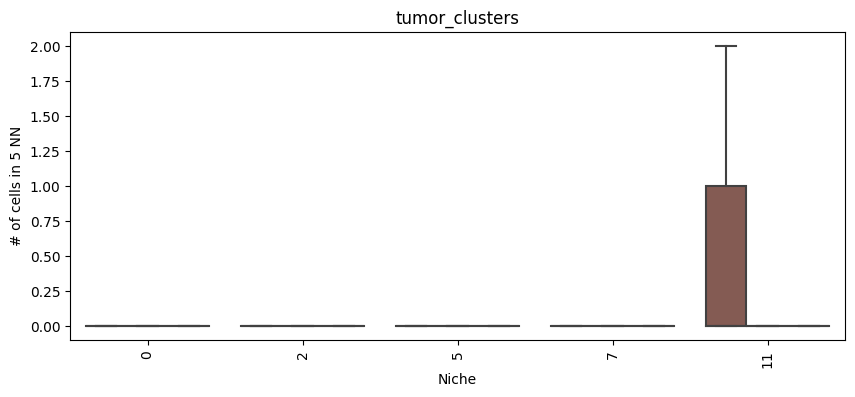

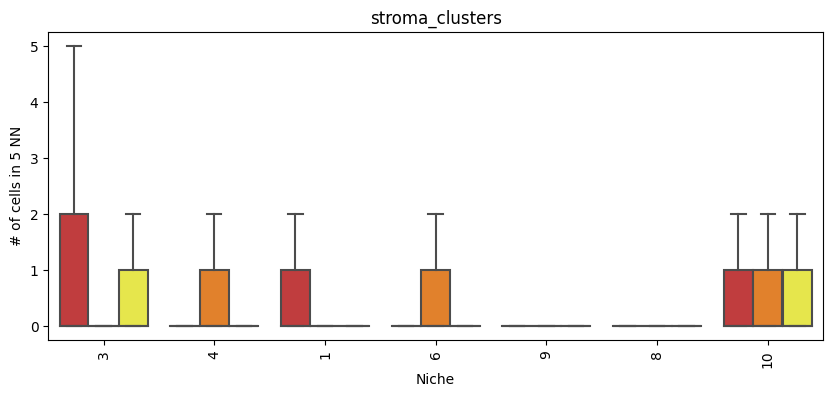

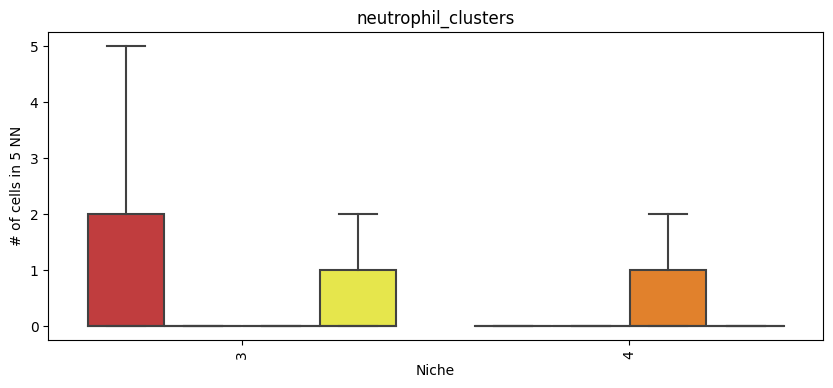

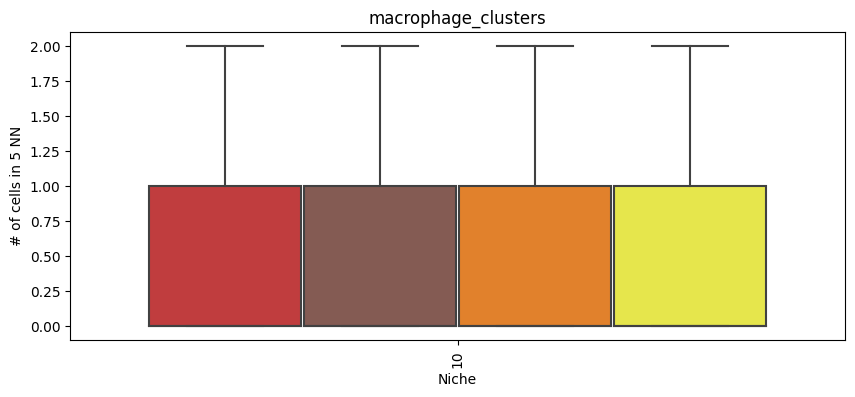

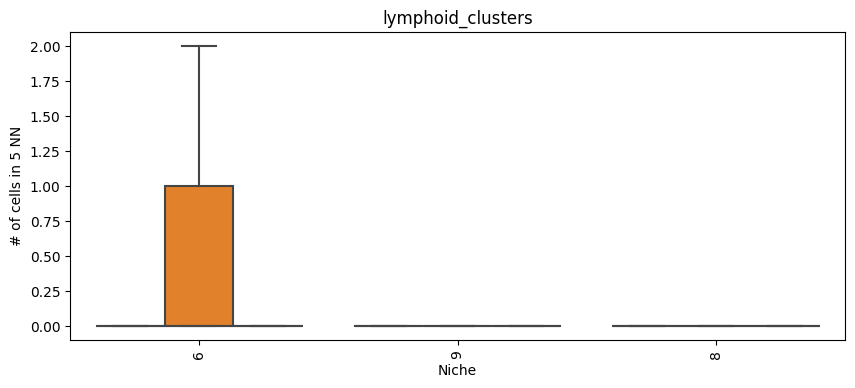

...

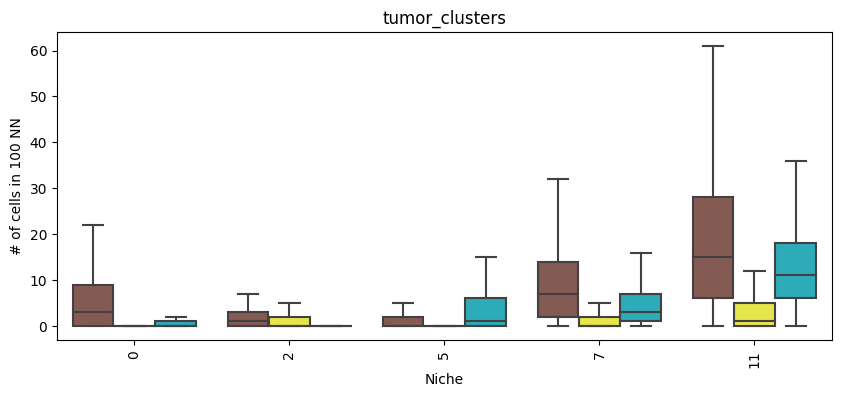

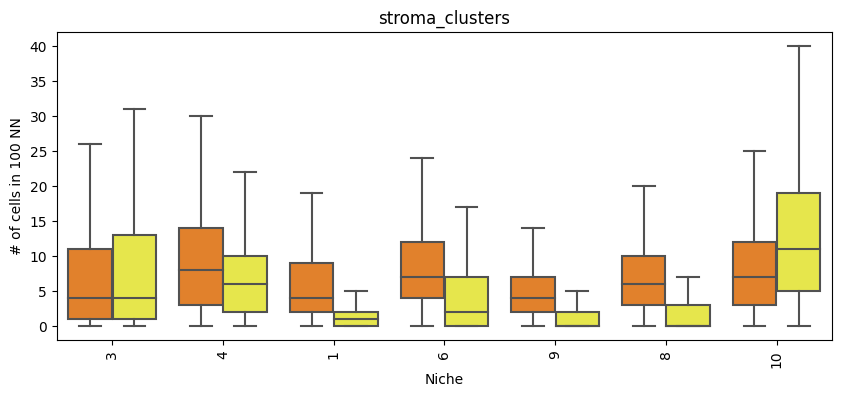

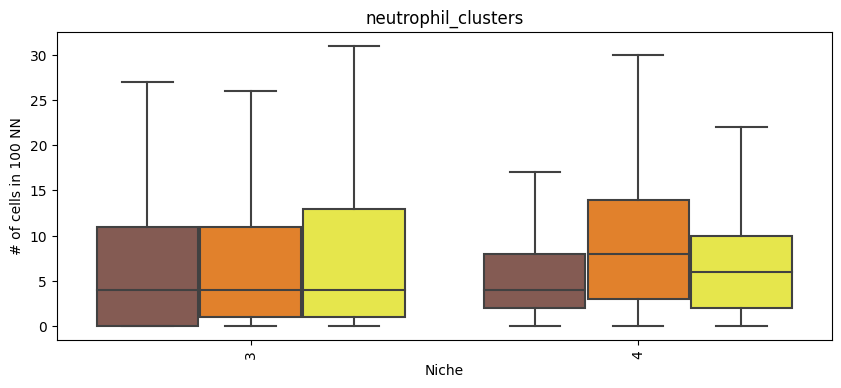

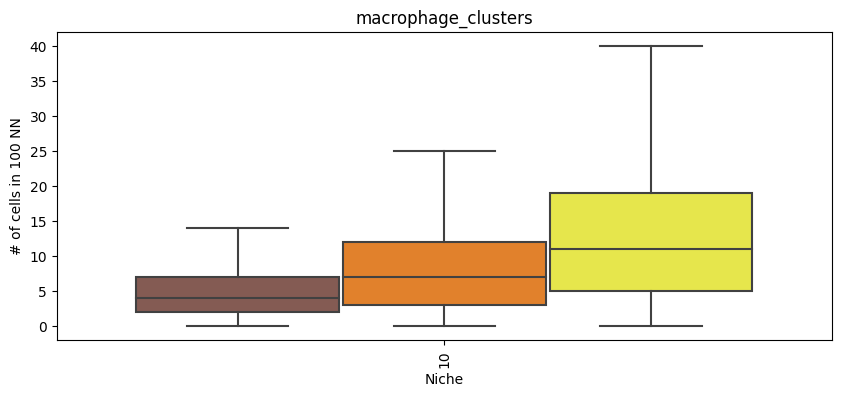

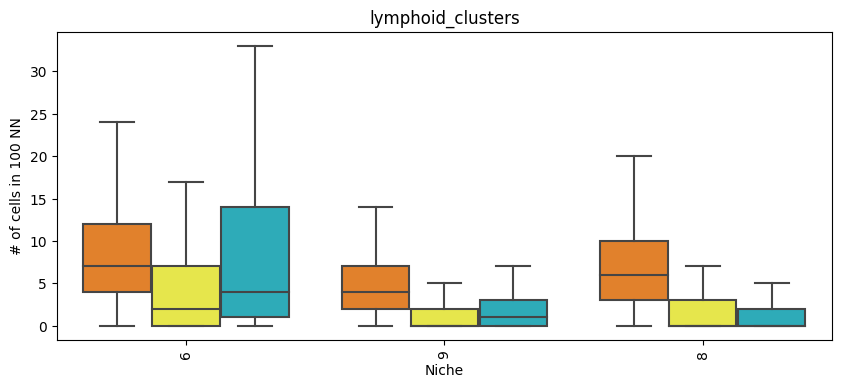

In [160]:
from sklearn.neighbors import NearestNeighbors
rcParams['figure.figsize'] = (10, 4)

for n in [5, 10, 15, 25, 50, 100]:
    # compute n neighbours per cell type
    knn = {}
    cell_counts = {}
    for b in adata.obs.batch.unique():
        X = adata[adata.obs.batch==b].obsm['spatial']
        celltypes = adata[adata.obs.batch==b].obs.cell_type.astype(str).values.astype('<U22')
        celltypes[np.char.find(celltypes, 'tumor') != -1] = 'tumor'
        celltypes[np.char.find(celltypes, 'T ') != -1] = 'T cell'    
        cellnames = adata[adata.obs.batch==b].obs_names

        knn[b] = NearestNeighbors(n_neighbors=n)
        knn[b].fit(X)
        knn[b] = knn[b].kneighbors(X, return_distance=False)    
        knn[b] = celltypes[knn[b]]

        for i in range(len(cellnames)):
            unique, counts = np.unique(knn[b][i,:], return_counts=True)
            cell_counts[cellnames[i]] = dict(zip(unique, counts))

    adata.obsm[f'k{n}_neighbours_celltype'] = pd.DataFrame(cell_counts).T.fillna(0)
    
    for structure, groups in adata.uns['cluster_groups'][leiden_col_key].items():
        # format for plotting and keep only those with an interesting number
        dt = adata.obsm[f'k{n}_neighbours_celltype']
        dt[leiden_col_key] = adata.obs[leiden_col_key]
        # groups = adata.uns['cluster_groups'][leiden_col_key]['tumor_clusters']
        dt = dt.loc[dt[leiden_col_key].isin(groups),:]
        dt[leiden_col_key] = dt[leiden_col_key].cat.remove_unused_categories()
        dt = dt.reset_index()
        dt = pd.melt(dt, id_vars=['index',leiden_col_key], value_name=f'n NN/{n}', var_name='cell type')
        dt['cell type'] = pd.Categorical(dt['cell type'], categories=adata.obs['cell type'].cat.categories)
        # dt = dt[~dt['cell type'].isin(['tumor'])]
        include = (dt.groupby(['cell type',leiden_col_key])[f'n NN/{n}'].mean().groupby(['cell type']).max() > n*0.04) & (dt.groupby(['cell type',leiden_col_key])[f'n NN/{n}'].mean().groupby(['cell type']).max() < n*0.2)
        dt = dt[dt['cell type'].isin(include[include].index.values)]
        dt['cell type'] = dt['cell type'].cat.remove_unused_categories()

        # plot
        sns.boxplot(data=dt, x=leiden_col_key, y=f'n NN/{n}', hue='cell type', palette=adata.uns[f'cell type_colors'][include.values], showfliers = False).set(title=structure)
        plt.xticks(rotation=90)
        plt.xlabel("Niche")
        plt.ylabel(f'# of cells in {n} NN')
        plt.legend([],[], frameon=False)
        plt.show()
rcParams['figure.figsize'] = (4, 3)

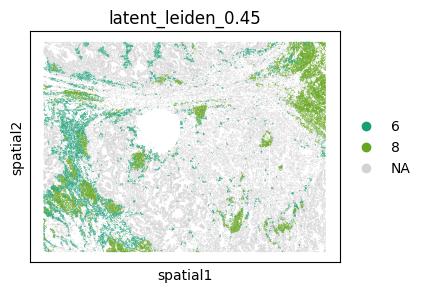

In [149]:
sc.pl.embedding(adata[adata.obs.batch=='lung5_rep1'], basis="spatial", color=['latent_leiden_0.45'], size=1, groups=['6','8'])

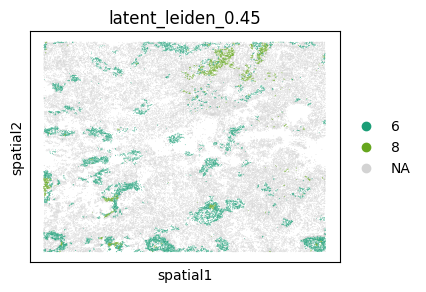

In [150]:
sc.pl.embedding(adata[adata.obs.batch=='lung12'], basis="spatial", color=['latent_leiden_0.45'], size=1, groups=['6','8'])

### reference + r3

In [51]:
adata, adata_path = load_adata(suffix='43_3', model='reference_query_mapping')

In [53]:
prev= adata.uns['batch_colors']

In [54]:
adata.uns['batch_colors'] = list(np.array(adata.uns['batch_colors'])[[0,1,6,2,3,4,5]])

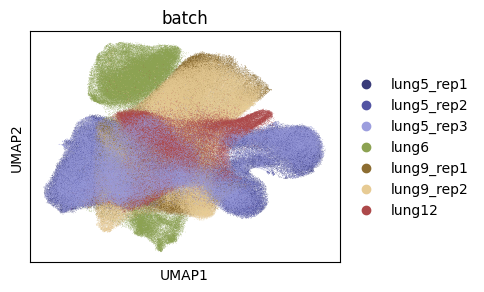

In [55]:
sc.pl.umap(adata, color=['batch'], ncols=4, wspace=0.3, size=0.5)

In [38]:
batch_colors = np.apply_along_axis(to_hex, 1, np.array(plt.get_cmap('tab20b').colors)[[0,1,3,5,8,11,13,17],:])
adata.uns['batch_colors'] = {b: c for b, c in zip(['lung5_rep1','lung5_rep2','lung5_rep3','lung6','lung9_rep1','lung9_rep2','lung12','lung13'], batch_colors)}


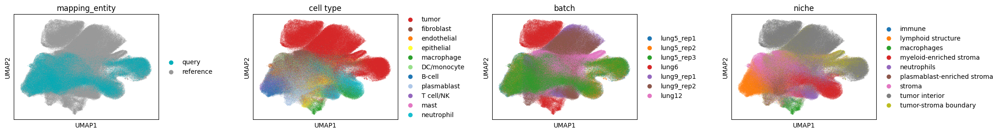

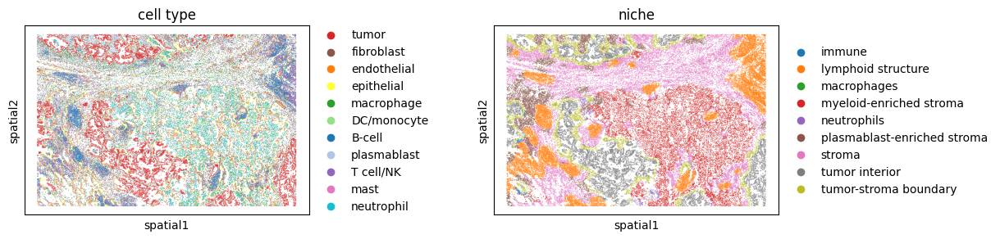

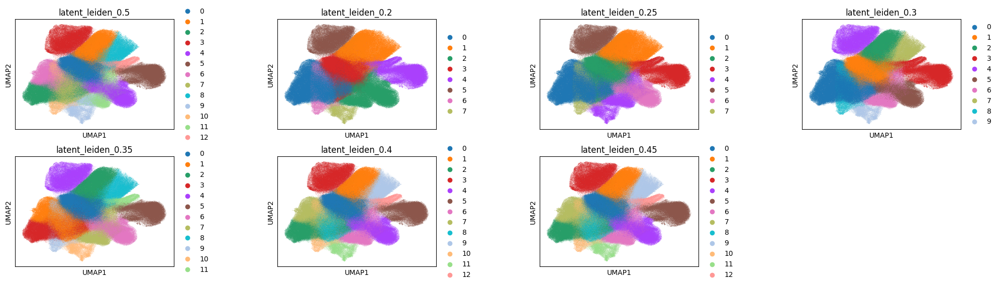

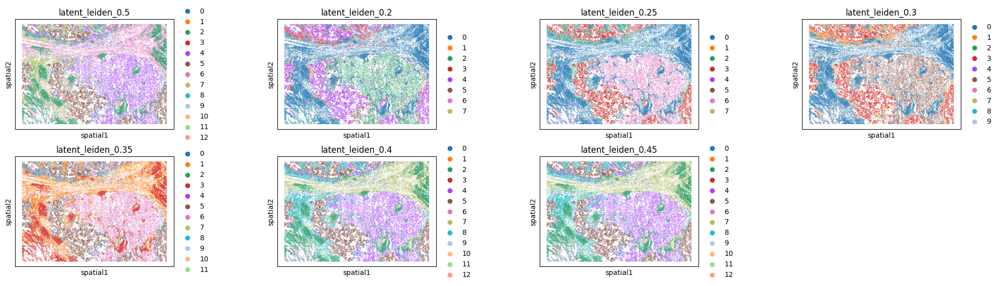

In [39]:
plot_latent(adata, model='reference_query_mapping')

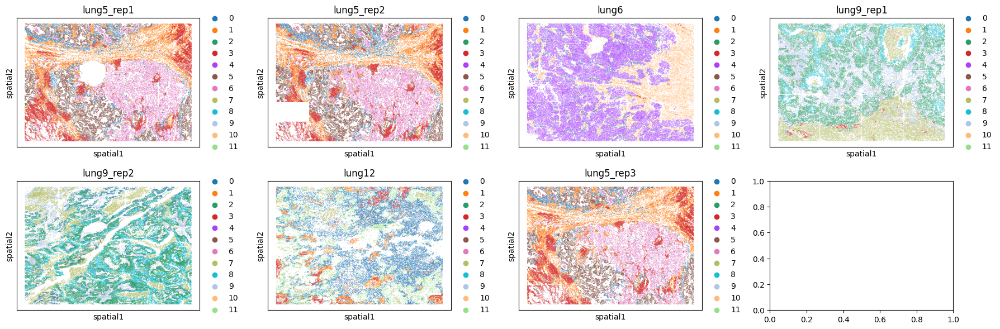

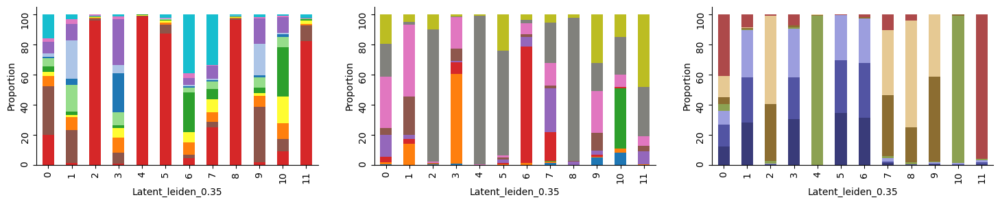

In [56]:
latent_leiden_resolution=0.35
res_details(adata, resolution=latent_leiden_resolution, model='reference_query_mapping')

In [31]:
if not 'cluster_grups' in adata.uns:
    adata.uns['cluster_groups'] = {}
    
adata.uns['cluster_groups'][f"latent_leiden_{latent_leiden_resolution}"] = {
    'tumor_clusters': ['2','4','5','8','11'],
    'stroma_clusters': ['0','1'],
    'neutrophil_clusters': ['6','7'],
    'macrophage_clusters': ['10'],
    'lymphoid_clusters': ['3','9']
}

In [32]:
adata.write_h5ad(adata_path)
del adata
gc.collect()

In [57]:
del adata
gc.collect()

65538

### reference + s13

In [8]:
adata, adata_path = load_adata(suffix='43_8', model='reference_query_mapping')

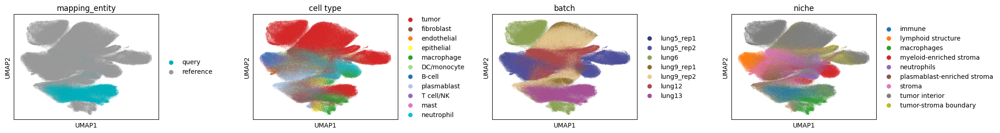

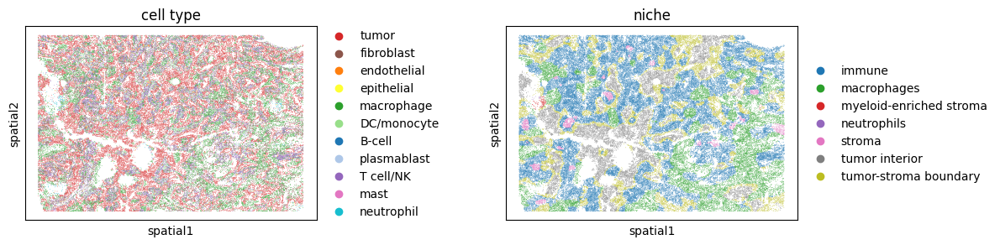

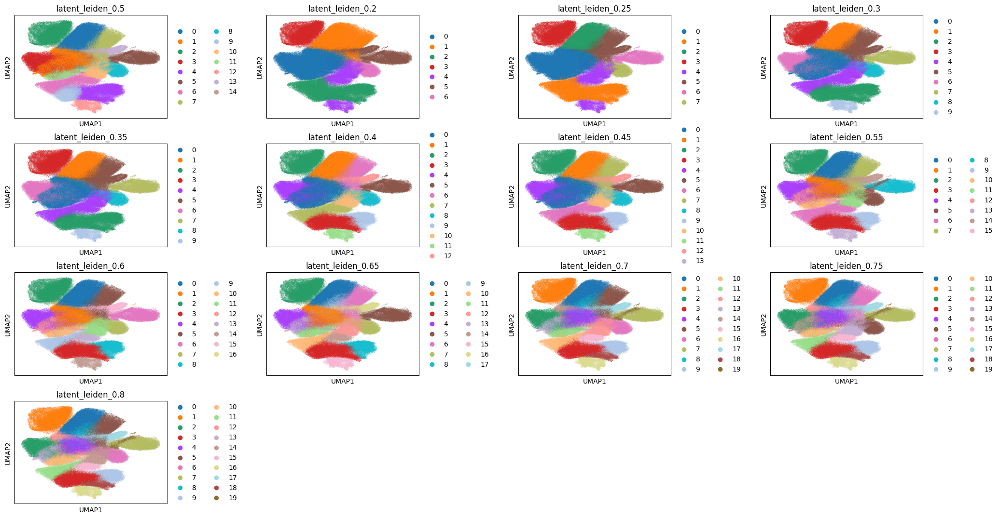

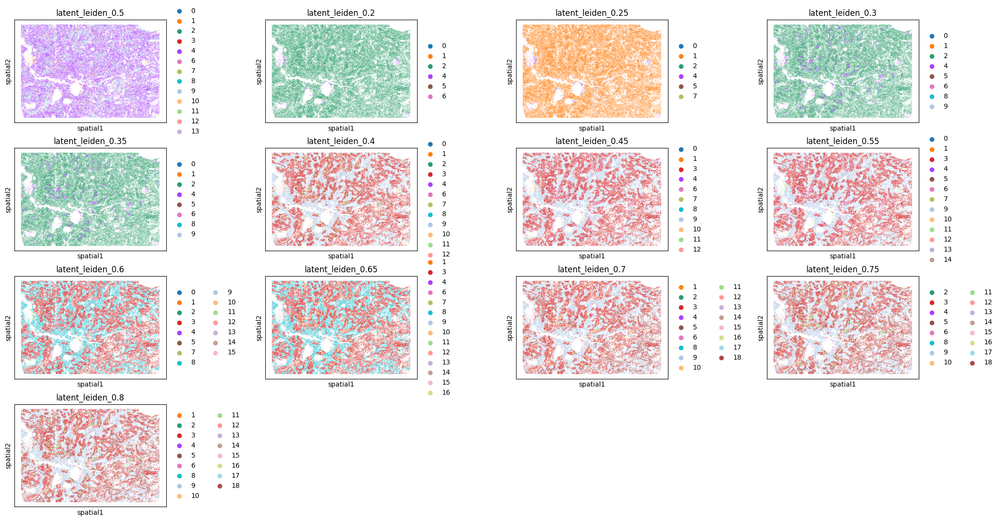

In [9]:
plot_latent(adata, model='reference_query_mapping')

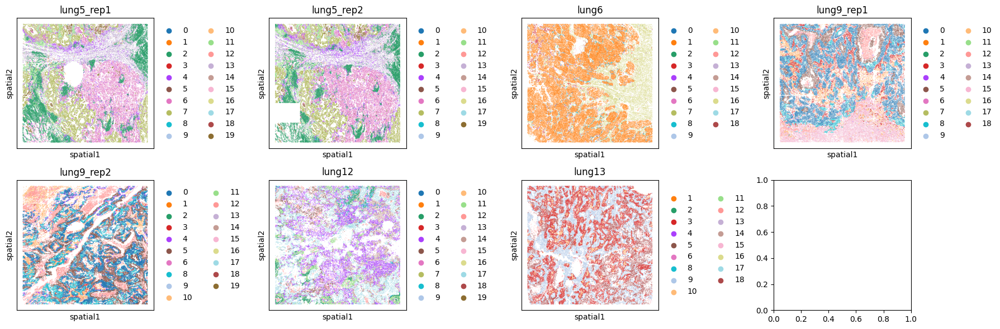

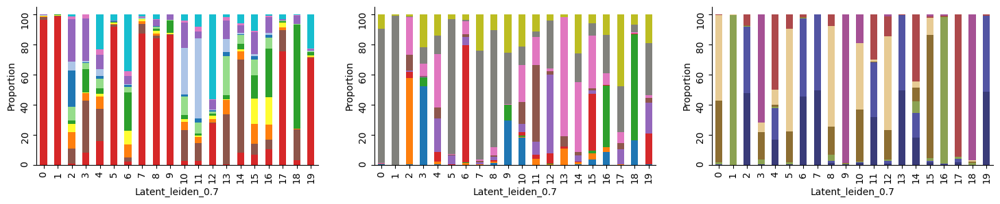

In [10]:
latent_leiden_resolution=0.7
res_details(adata, resolution=latent_leiden_resolution, model='reference_query_mapping')

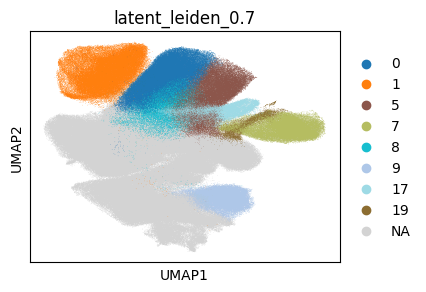

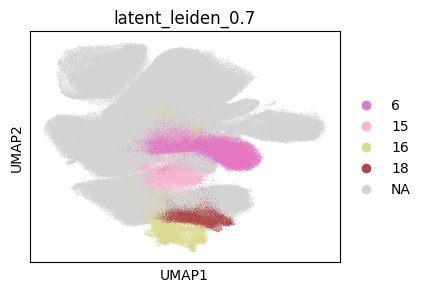

In [64]:
sc.pl.umap(adata, color=['latent_leiden_0.7'], ncols=4, wspace=0.3, size=0.5, groups=adata.uns['cluster_groups'][f"latent_leiden_0.7"]['tumor_clusters'])
sc.pl.umap(adata, color=['latent_leiden_0.7'], ncols=4, wspace=0.3, size=0.5, groups=adata.uns['cluster_groups'][f"latent_leiden_0.7"]['macrophage_clusters'])

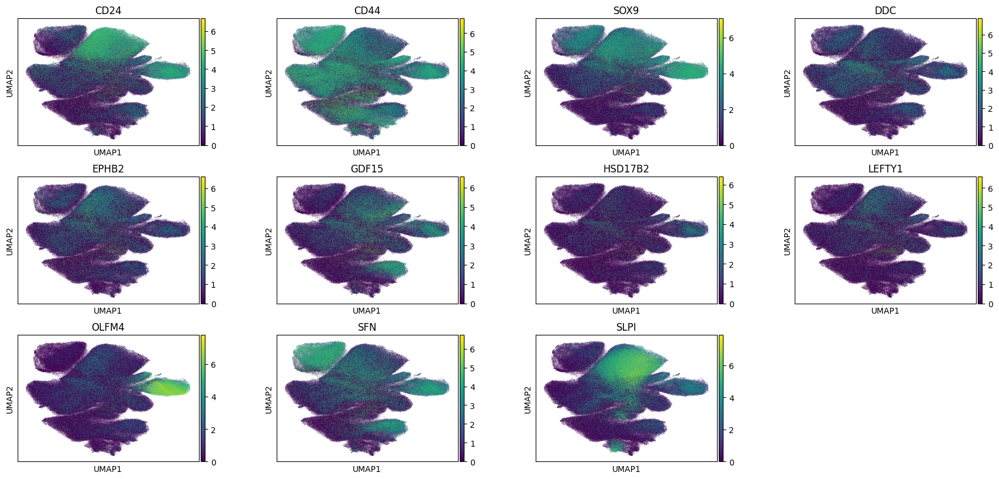

In [22]:
stem_cells_markers = np.array(['CD24', 'DCLK1', 'LGR5', 'CD166', 'CD44', 'DCAMKL-1', 'SOX9', 'ACAD10', 'ACVR1C', 'ADH1C', 'ALDH1', 'ALK3', 'ARSE', 
'ASCL2', 'ATP10B', 'BMI1', 'C16orf89', 'C6orf136', 'CD29', 'CDCA7', 'CFTR','CHMP4C', 'CHP2', 'CLDN15', 'CLDN18', 'CLDN2', 'CPA6', 'DAPK2', 
'DDC', 'EFNA3', 'EPHB2', 'EPYC', 'EVPL', 'F2RL1', 'FBLN2', 'FOXD2-AS1', 'GATA6-AS1', 'GDF15', 'GJB1', 'GJB1', 'GOLT1A', 'GPX2', 'HNF1A', 
'HSD17B2', 'ITPKC','LEFTY1', 'LHFPL3-AS2', 'LIPG', 'LY6G6D', 'MGST1', 'MSI1', 'MYOM3', 'Musashi-1', 'NOX1', 'OLFM4', 'PCSK9', 'PDZD3', 
'PHLDA1', 'PKP2', 'PLAGL2', 'PLEKHH1', 'PPP1R1B', 'PTGDR', 'PTK7', 'RGMB', 'RNF157', 'RNF186', 'SFN', 'SLC27A2', 'SLC38A4', 'SLPI',
'SULT1B1', 'TAF4B', 'TANC1', 'TMEM171', 'TSPAN8', 'Telomerase Inhibitors', 'URB1-AS1', 'ZBED9', 'ZNF296', 'ASCL2', 'SMOC2'])
stem_cells_markers = [sc for sc in stem_cells_markers if sc in adata.var_names]
sc.pl.umap(adata, color=stem_cells_markers, ncols=4, wspace=0.3, size=0.5)

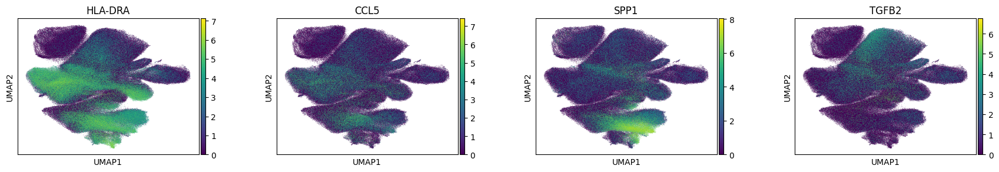

In [70]:
sc.pl.umap(adata, color=['HLA-DRA','CCL5','SPP1','TGFB2'], ncols=4, wspace=0.3, size=0.5)

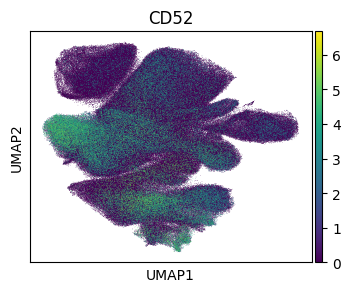

In [87]:
sc.pl.umap(adata, color=['CD52'], ncols=4, wspace=0.3, size=0.5)

In [72]:
from sklearn.neighbors import NearestNeighbors
import pandas as pd
n=25
knn = {}
cell_counts = {}
for b in adata.obs.batch.unique():
    X = adata[adata.obs.batch==b].obsm['spatial']
    celltypes = adata[adata.obs.batch==b].obs.cell_type.astype(str).values.astype('<U22')
    celltypes[np.char.find(celltypes, 'tumor') != -1] = 'tumor'
    celltypes[np.char.find(celltypes, 'T ') != -1] = 'T cell'    
    cellnames = adata[adata.obs.batch==b].obs_names
    
    knn[b] = NearestNeighbors(n_neighbors=n)
    knn[b].fit(X)
    knn[b] = knn[b].kneighbors(X, return_distance=False)    
    knn[b] = celltypes[knn[b]]
    
    for i in range(len(cellnames)):
        unique, counts = np.unique(knn[b][i,:], return_counts=True)
        cell_counts[cellnames[i]] = dict(zip(unique, counts))
        
adata.obsm['k{n}_neighbours_celltype'] = pd.DataFrame(cell_counts).T.fillna(0)     

for col in ['tumor', 'endothelial', 'fibroblast','myeloid', 'T cell', 'B-cell', 'plasmablast', 'mast', 'neutrophil']:
    adata.obs.loc[:,f'nn_{col}'] = adata.obsm['k{n}_neighbours_celltype'][col].values

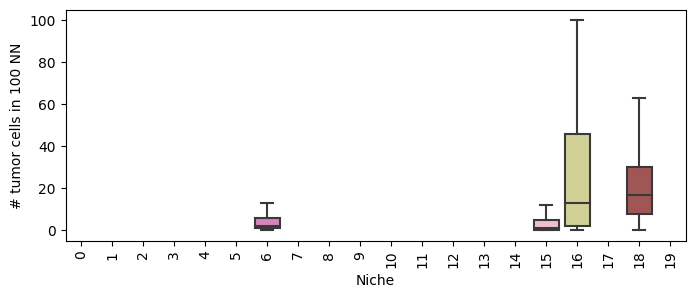

In [77]:
rcParams['figure.figsize'] = (8, 3)
leiden_col_key='latent_leiden_0.7'
groups = adata.uns['cluster_groups'][leiden_col_key]['macrophage_clusters']
score = 'tumor'
sns.boxplot(data=adata.obs.loc[adata.obs[leiden_col_key].isin(groups),[leiden_col_key,f'nn_{score}']], x=leiden_col_key, y=f'nn_{score}', palette=adata.uns[f'{leiden_col_key}_colors'], showfliers = False)
plt.xticks(rotation=90)
plt.xlabel("Niche")
plt.ylabel(f'# {score} cells in {n} NN')
plt.show()

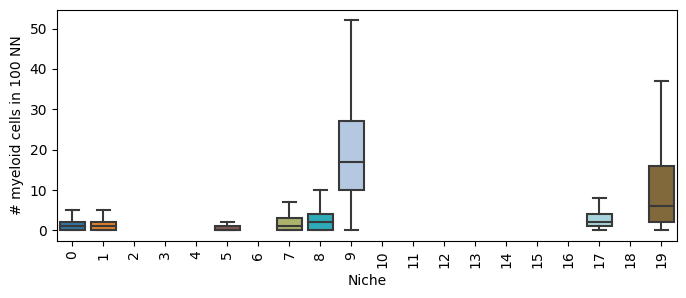

In [78]:
rcParams['figure.figsize'] = (8, 3)
leiden_col_key='latent_leiden_0.7'
groups = adata.uns['cluster_groups'][leiden_col_key]['tumor_clusters']
score = 'myeloid'
sns.boxplot(data=adata.obs.loc[adata.obs[leiden_col_key].isin(groups),[leiden_col_key,f'nn_{score}']], x=leiden_col_key, y=f'nn_{score}', palette=adata.uns[f'{leiden_col_key}_colors'], showfliers = False)
plt.xticks(rotation=90)
plt.xlabel("Niche")
plt.ylabel(f'# {score} cells in {n} NN')
plt.show()

In [ ]:
sc.pl.embedding(adata[adata.obs.batch==''], basis="spatial", color=['PDCD1','CD274'], ncols=4, wspace=0.3, size=2)

In [63]:
if not 'cluster_grups' in adata.uns:
    adata.uns['cluster_groups'] = {}
    
adata.uns['cluster_groups'][f"latent_leiden_0.7"] = {
    'tumor_clusters': ['9','0','1','5','7','8','17','19'],
    'macrophage_clusters': ['18','6','15','16'],
}

In [14]:
del adata
gc.collect()

91298

In [12]:
adata.write_h5ad(adata_path)
del adata
gc.collect()

# Reference 49
no contrastive, L1 0 add on, 1000 masked, decrease kl x10, 0.03 active GPs

## Select resolution

### reference

In [9]:
adata, adata_path = load_adata(suffix='49', model='reference')

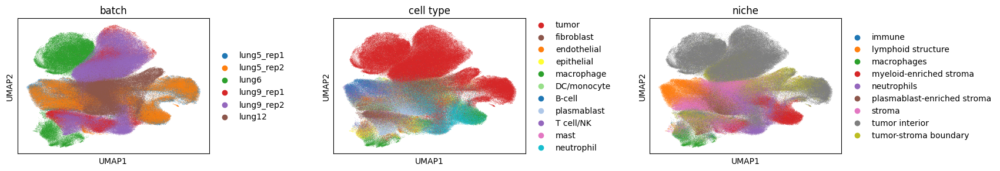

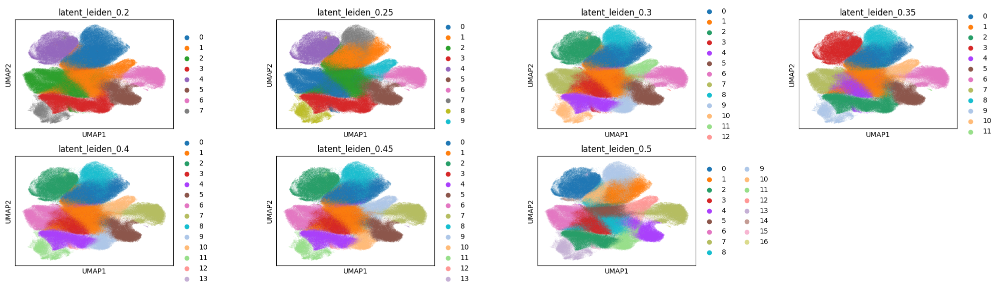

In [10]:
plot_latent(adata, model='reference')

In [ ]:
latent_leiden_resolution=0.4
res_details(adata, resolution=latent_leiden_resolution, model='reference')

In [ ]:
if not 'cluster_grups' in adata.uns:
    adata.uns['cluster_groups'] = {}
    
adata.uns['cluster_groups'][f"latent_leiden_{latent_leiden_resolution}"] = {
    'tumor_clusters': [],
    'stroma_clusters': [],
    'neutrophil_clusters': [],
    'macrophage_clusters': [],
    'lymphoid_clusters': []
}

In [18]:
# adata.write_h5ad(adata_path)
del adata
gc.collect()

87410

### reference + r3

In [16]:
adata, adata_path = load_adata(suffix='49_3', model='reference_query_mapping')

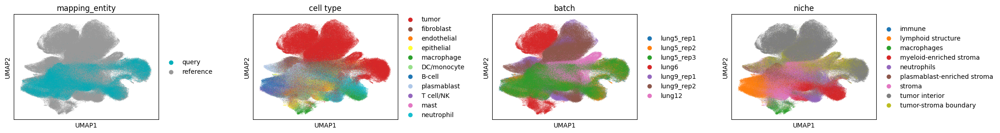

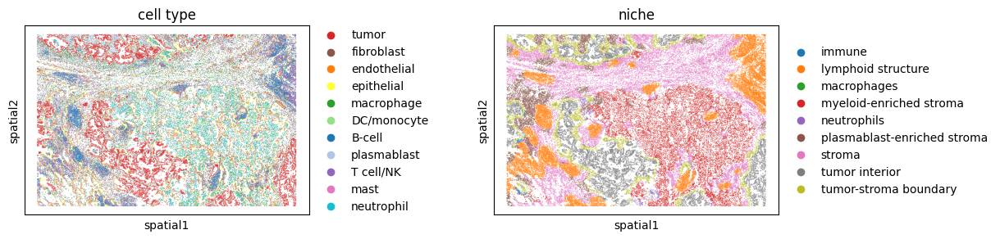

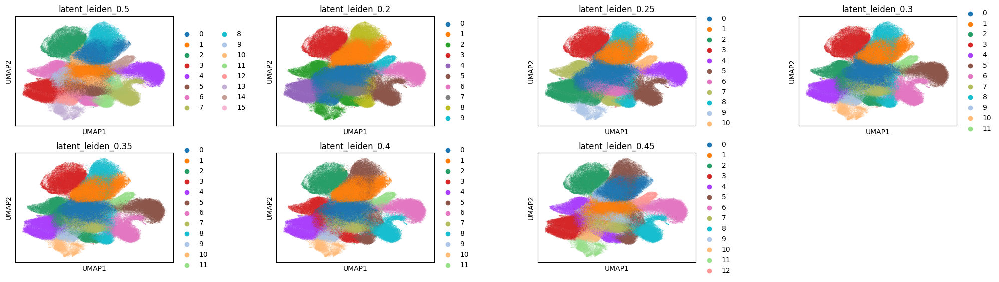

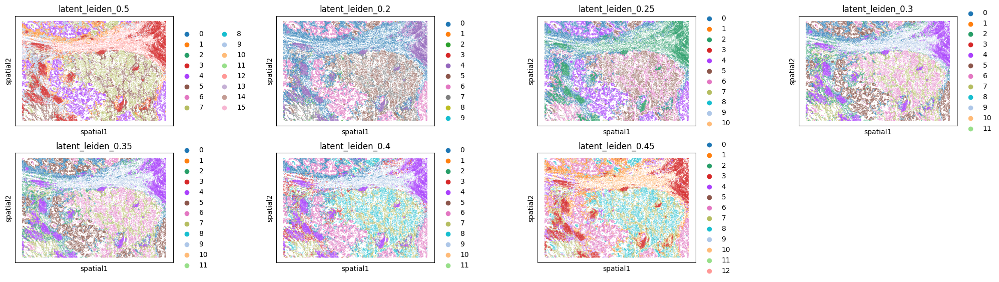

In [17]:
plot_latent(adata, model='reference_query_mapping')

In [ ]:
latent_leiden_resolution=0.4
res_details(adata, resolution=latent_leiden_resolution, model='reference_query_mapping')

In [ ]:
if not 'cluster_grups' in adata.uns:
    adata.uns['cluster_groups'] = {}
    
adata.uns['cluster_groups'][f"latent_leiden_{latent_leiden_resolution}"] = {
    'tumor_clusters': [],
    'stroma_clusters': [],
    'neutrophil_clusters': [],
    'macrophage_clusters': []
}

adata.write_h5ad(adata_path)
del adata
gc.collect()

### reference + s13

In [19]:
adata, adata_path = load_adata(suffix='49_8', model='reference_query_mapping')

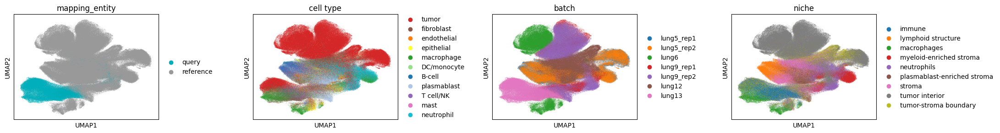

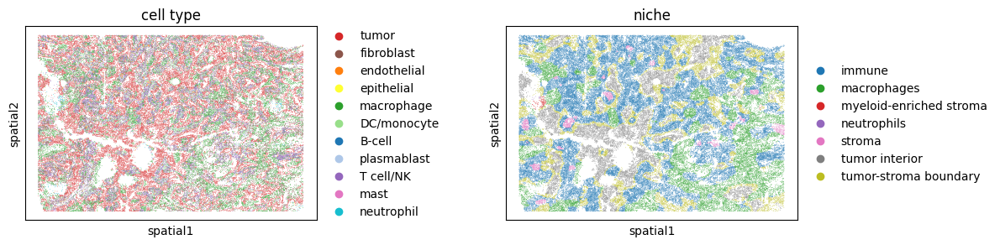

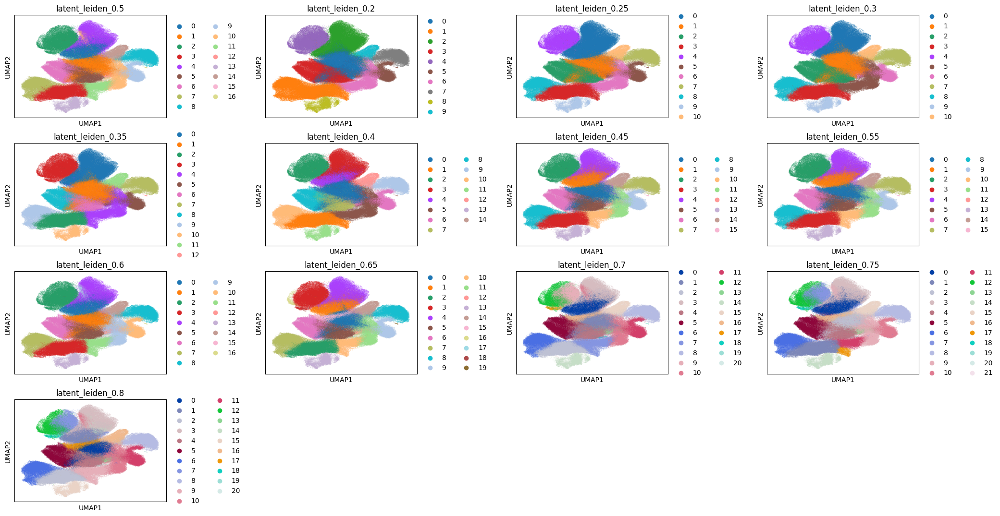

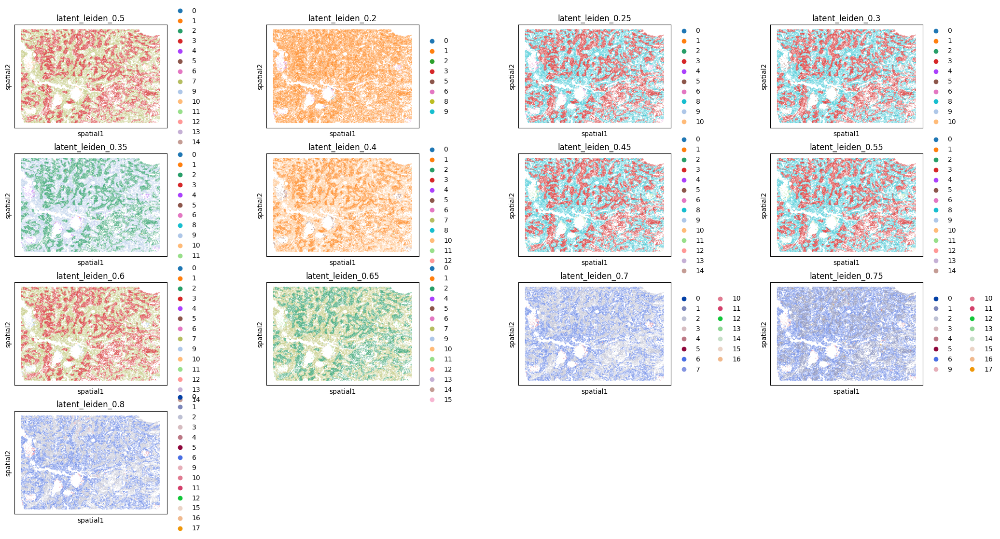

In [20]:
plot_latent(adata, model='reference_query_mapping')

In [ ]:
latent_leiden_resolution=0.4
res_details(adata, resolution=latent_leiden_resolution, model='reference_query_mapping')

In [ ]:
if not 'cluster_grups' in adata.uns:
    adata.uns['cluster_groups'] = {}
    
adata.uns['cluster_groups'][f"latent_leiden_{latent_leiden_resolution}"] = {
    'tumor_clusters': [],
    'stroma_clusters': [],
    'neutrophil_clusters': [],
    'macrophage_clusters': [],
    'lymphoid_clusters': []
}

In [ ]:
adata.write_h5ad(adata_path)
del adata
gc.collect()